### Zadania

Celem zadań jest napisanie (fragmentów) programów, które wyodrębnią obiekty znajdujące się na podanych obrazach. Rozumie się przez to doprowadzenie obrazów do postaci binarnej z wyraźną separacją między obiektami a tłem oraz poszczególnymi obiektami.

Samo osiągnięcie "jakiegoś" wyniku ([`cv2.threshold`](https://docs.opencv.org/3.4/d7/d1b/group__imgproc__misc.html#gae8a4a146d1ca78c626a53577199e9c57) odpalone, próg wybrany "z palca", _coś tam_ widać, wynik wyświetlony) to co najwyżej połowa sukcesu (i oceny). Ważne jest pokazanie w drodze eksperymentu odpowiedzi na pytania - czy te podane w treści zadania, czy takie, które się Tobie nasunęły.

In [3]:
import cv2
import numpy as np
from PIL import Image

##### Zad. 1: Monety szare

Dane są dwa czarno-białe obrazy monet, `monety_szare` oraz `monety_szare_szum`, z których drugi zawiera pewien poziom zakłóceń. Dokonaj binaryzacji tych obrazów za pomocą progowania.  
W jaki sposób ustalisz wartość progu? Jak wartość progu wpływa na wyniki?  
Jaki wpływ mają zakłócenia w drugim obrazie? Jak się ich pozbędziesz?

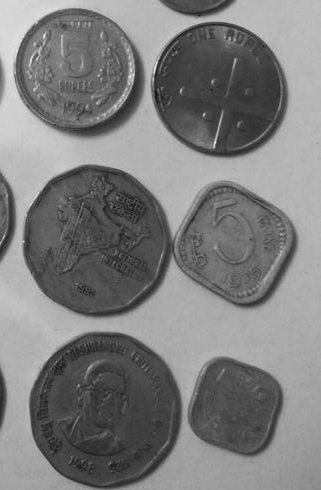

In [3]:
# 1A
monety_szare = cv2.imread('Monety_szare.bmp')
Image.fromarray(cv2.cvtColor(monety_szare, cv2.COLOR_BGR2RGB))

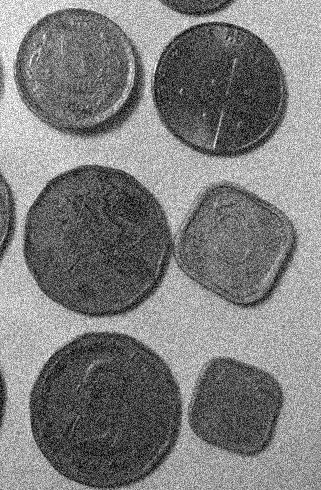

In [4]:
# 1B
monety_szare_szum = cv2.imread('Monety_szare_szum.bmp')
Image.fromarray(cv2.cvtColor(monety_szare_szum, cv2.COLOR_BGR2RGB))

Rozwiązanie części 1A:

In [32]:
type(monety_szare)
monety_szare.shape

(490, 321, 3)

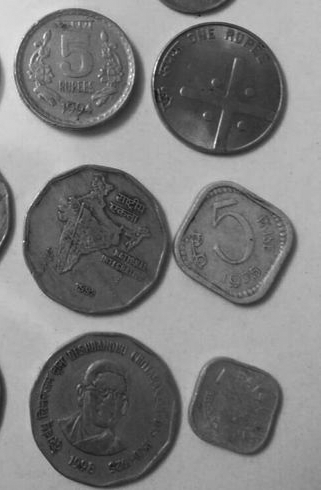

In [33]:

monety_szare_gray = cv2.cvtColor(monety_szare, cv2.COLOR_BGR2GRAY)
Image.fromarray(monety_szare_gray)

In [46]:
import matplotlib.pyplot as plt # type: ignore

In [44]:
def show_histogram(image):
    plt.hist(image[..., 0].flatten(), bins=255)
    plt.show()

In [28]:
def apply_threshold(image, threshold, max_value):
    (T, img_thresh) = cv2.threshold(image, threshold, max_value, cv2.THRESH_BINARY_INV)

    print("Próg: ", T)
    return img_thresh

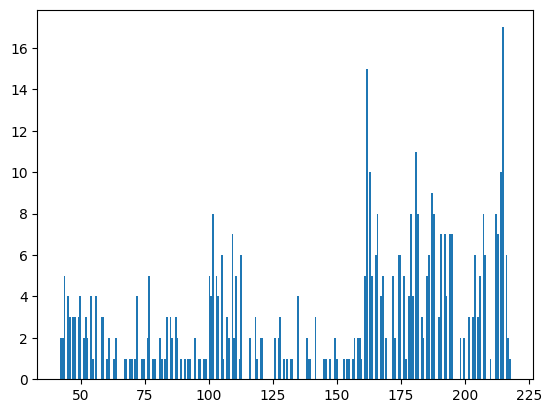

In [34]:
# histogram grayscale
show_histogram(monety_szare_gray)

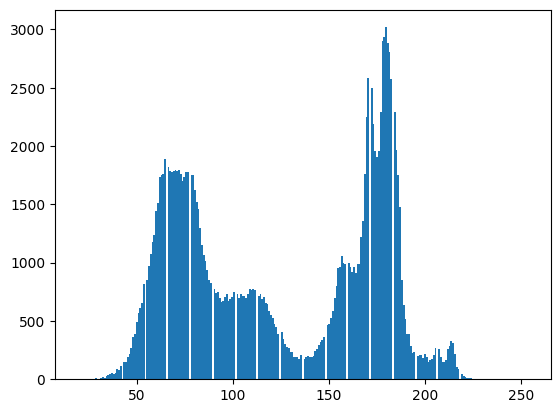

In [35]:
# histogram rgb
show_histogram(monety_szare)

No najelpszym było znalezienie progu analizując histogram. Mamy wiele wartości szarych, oraz jaśniejszych. Na histogramie widać lukę występujących pikseli.

Można spróbować z 'palca' i 'oka' znaleźć wartość progu, która oddzieli tło od monet.

Próg:  140.0


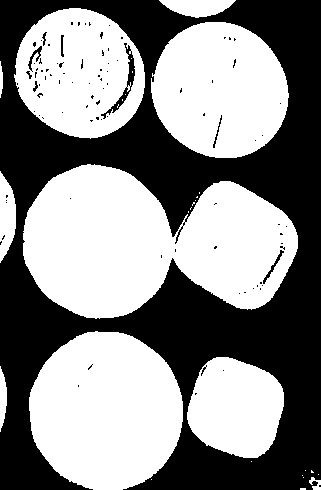

In [30]:
img_thres = apply_threshold(monety_szare, 140, 255)
Image.fromarray(img_thres)

Próg:  140.0


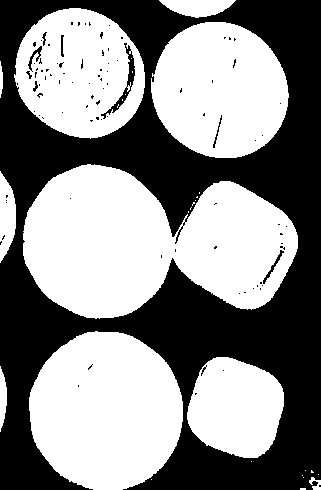

In [39]:
# grayscale
img_thres_gray = apply_threshold(monety_szare_gray, 140, 255)
Image.fromarray(img_thres_gray)

No i niby ok, natomiast widać, że monety posiadają taką teksturę, że niektóre piksele należące do monet nie należą do tła.

Użycie metody Otsu, która znajduje wartość progu, która minimalizuje wariancję międzyklasową. W tym przypadku, wartość progu jest znacznie wyższa niż wartość progu znaleziona 'z palca'.

https://docs.opencv.org/4.x/d7/d4d/tutorial_py_thresholding.html

In [42]:
T, otsu_thresh_img = cv2.threshold(
    monety_szare, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
)
print("Próg wyliczony algorytmem Otsu: ", T)

Image.fromarray(otsu_thresh_img)

error: OpenCV(4.10.0) /Users/xperience/GHA-Actions-OpenCV/_work/opencv-python/opencv-python/opencv/modules/imgproc/src/thresh.cpp:1559: error: (-2:Unspecified error) in function 'double cv::threshold(cv::InputArray, cv::OutputArray, double, double, int)'
> THRESH_OTSU mode:
>     'src_type == CV_8UC1 || src_type == CV_16UC1'
> where
>     'src_type' is 16 (CV_8UC3)


Próg wyliczony algorytmem Otsu:  127.0


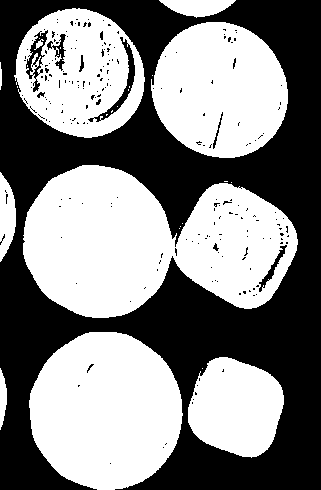

In [43]:
T, otsu_thresh_img = cv2.threshold(
    monety_szare_gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
)
print("Próg wyliczony algorytmem Otsu: ", T)

Image.fromarray(otsu_thresh_img)

Rozwiązanie części 1B:


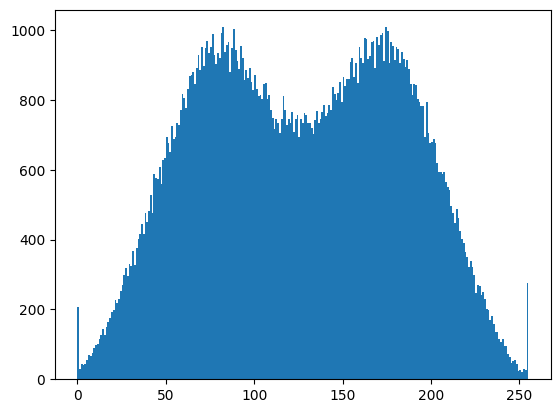

In [53]:
#histogram przed filtracja
show_histogram(monety_szare_szum)

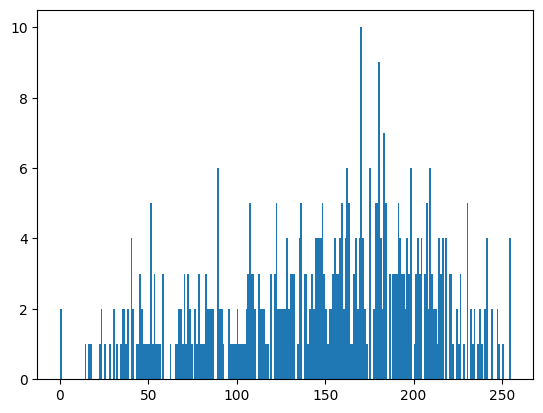

In [54]:
# histogram dla grayscale przed filtracja
monety_szare_szum_gray = cv2.cvtColor(monety_szare_szum, cv2.COLOR_BGR2GRAY)
show_histogram(monety_szare_szum_gray)

Próg:  120.0


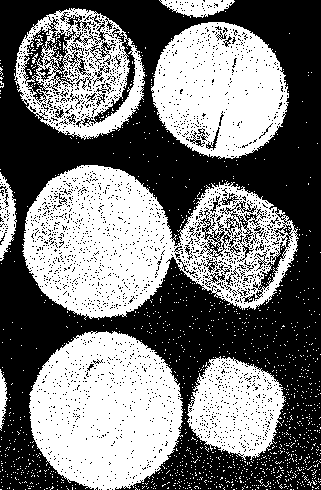

In [65]:
# nieskuteczny thresholding
monety_szare_szum_thresh = apply_threshold(monety_szare_szum, 120, 255)
Image.fromarray(monety_szare_szum_thresh)

Ostu

Próg wyliczony algorytmem Otsu:  125.0


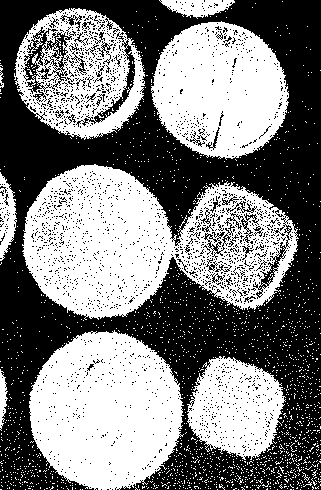

In [67]:
T, monety_szare_szum_otsu_thresh_img = cv2.threshold(
    monety_szare_szum_gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
)
print("Próg wyliczony algorytmem Otsu: ", T)

Image.fromarray(monety_szare_szum_otsu_thresh_img)

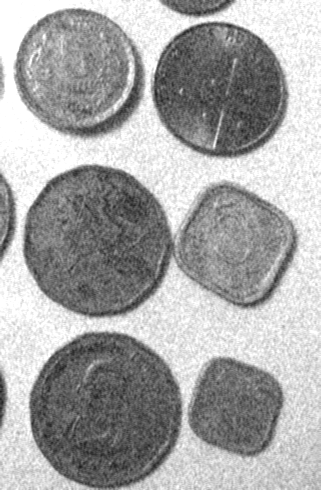

In [68]:
# obraz z szumem dlatego zastosujemy filtr uśredniający
kernel_blur_matrix = (
    np.array([[1, 2, 1], [1, 2, 1], [1, 2, 1]]) / 9
)

monety_szare_szum_blur = cv2.filter2D(src=monety_szare_szum_gray, ddepth=-1, kernel=kernel_blur_matrix)

Image.fromarray(monety_szare_szum_blur)

Otsu 

Próg wyliczony algorytmem Otsu:  168.0


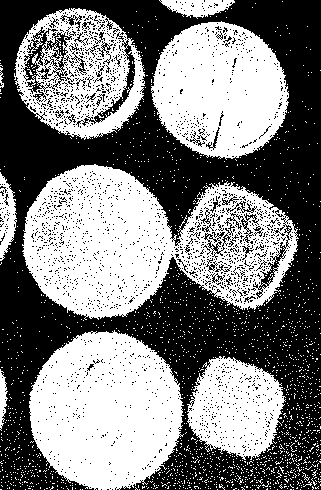

In [69]:
T, monety_szare_szum_blur_otsu_thresh_img = cv2.threshold(
    monety_szare_szum_blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
)
print("Próg wyliczony algorytmem Otsu: ", T)

Image.fromarray(monety_szare_szum_otsu_thresh_img)

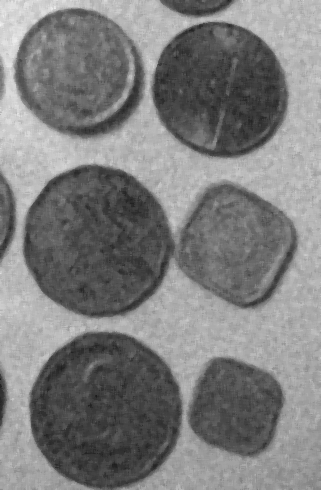

In [72]:

monety_szare_szum_median_blur = cv2.medianBlur(monety_szare_szum_gray, 5)

Image.fromarray(monety_szare_szum_median_blur)


Rzekomo medianowy jest dobry do usuwania "piprzu i soli" ale nie jestem pewien czy to jest to jest ten sam

Próg wyliczony algorytmem Otsu po median blur:  128.0


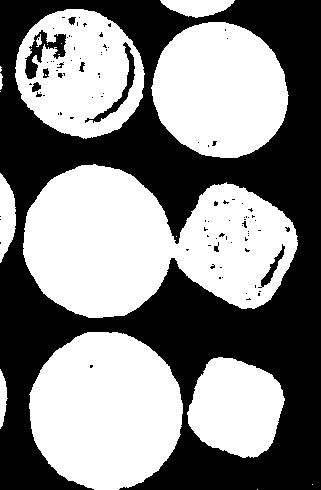

In [73]:

T, monety_szare_szum_median_blur_otsu_thresh_img = cv2.threshold(
    monety_szare_szum_median_blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
)
print("Próg wyliczony algorytmem Otsu po median blur: ", T)

Image.fromarray(monety_szare_szum_median_blur_otsu_thresh_img)

### GaussianBlur

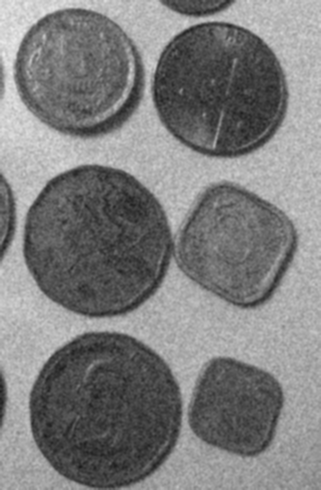

In [74]:
# Apply Gaussian blur to the noisy image
monety_szare_szum_gaussian_blur = cv2.GaussianBlur(monety_szare_szum_gray, (5, 5), 0)

# Display the blurred image
Image.fromarray(monety_szare_szum_gaussian_blur)


Próg wyliczony algorytmem Otsu po Gaussian blur:  127.0


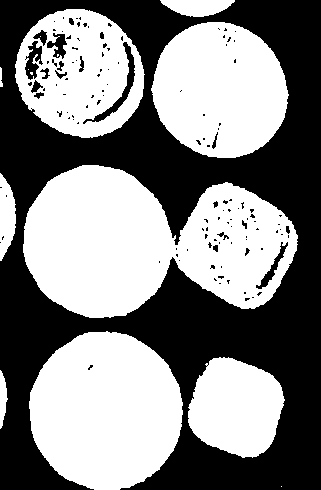

In [75]:

# Calculate Otsu's threshold after Gaussian blur
T, monety_szare_szum_gaussian_blur_otsu_thresh_img = cv2.threshold(
    monety_szare_szum_gaussian_blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
)
print("Próg wyliczony algorytmem Otsu po Gaussian blur: ", T)

# Display the thresholded image
Image.fromarray(monety_szare_szum_gaussian_blur_otsu_thresh_img)

##### Zad. 2: Monety kolorowe

Na podobnej zasadzie dokonaj binaryzacji poniższych obrazów kolorowych. Skorzystaj z modelu barw HSV. Uzasadnij dobór progu w oparciu o histogram wybranej składowej.

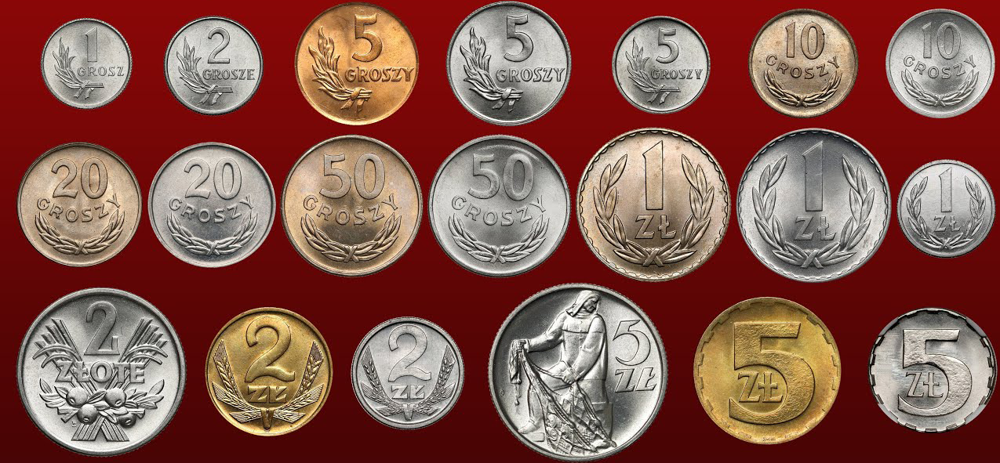

In [77]:
# 2A
monety_kolor = cv2.imread('Monety_kolor.bmp')
Image.fromarray(cv2.cvtColor(monety_kolor, cv2.COLOR_BGR2RGB))

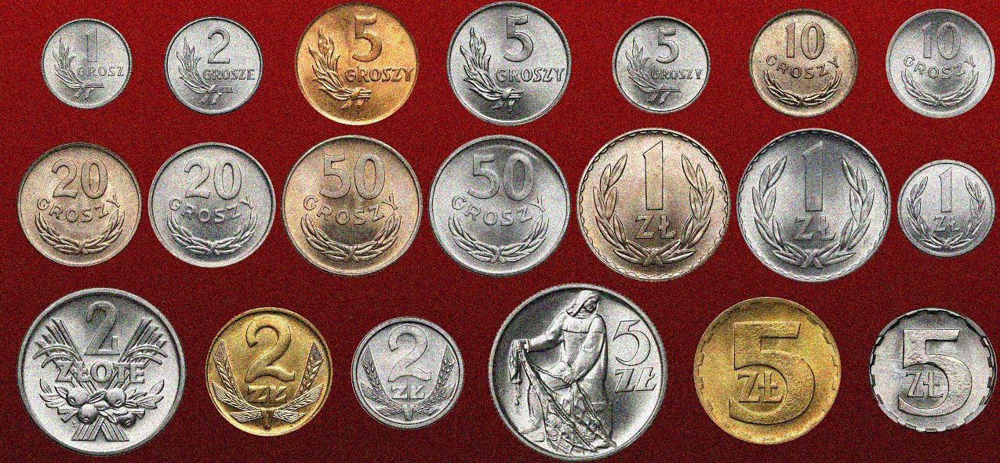

In [225]:
# 2B
monety_kolor_szum = cv2.imread('Monety_kolor_szum.bmp')
Image.fromarray(cv2.cvtColor(monety_kolor_szum, cv2.COLOR_BGR2RGB))

Rozwiązanie części 2A:

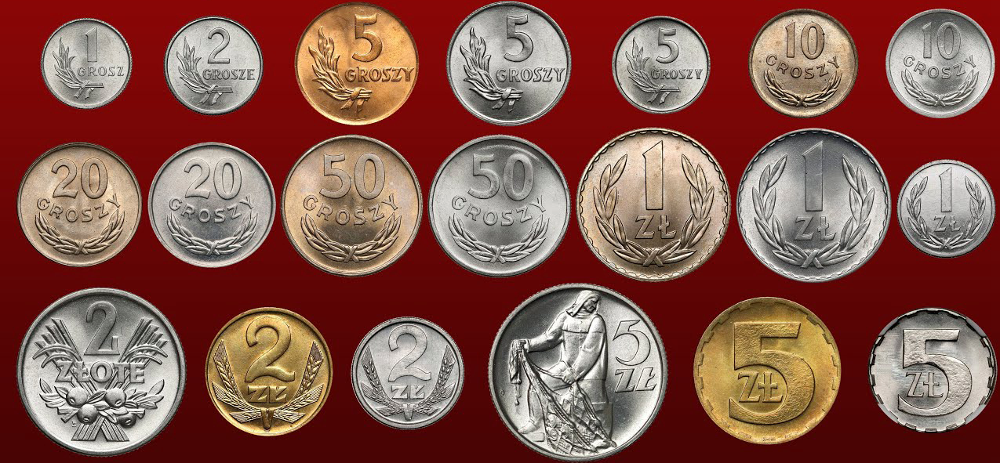

In [82]:
monety_kolor_hsv = cv2.cvtColor(monety_kolor, cv2.COLOR_BGR2HSV)
Image.fromarray(cv2.cvtColor(monety_kolor_hsv, cv2.COLOR_HSV2RGB))

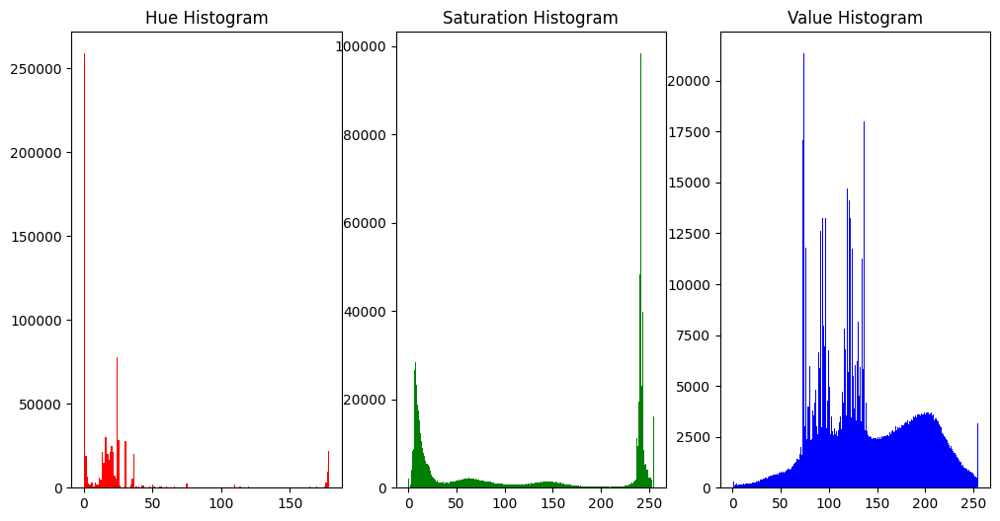

In [171]:
def show_hsv_histogram(image):
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv_image)
    
    plt.figure(figsize=(12, 6))
    
    plt.subplot(131)
    plt.hist(h.flatten(), bins=180, color='r')
    plt.title('Hue Histogram')
    
    plt.subplot(132)
    plt.hist(s.flatten(), bins=256, color='g')
    plt.title('Saturation Histogram')
    
    plt.subplot(133)
    plt.hist(v.flatten(), bins=256, color='b')
    plt.title('Value Histogram')
    
    plt.show()

show_hsv_histogram(monety_kolor)

Widać, że jest dużo koloru czerwonego = 0 i 180 stopni. widać, przerwę pomiędzy kolejnymi wartościami hue.

Również widać, analizując histogram saturation, że wartości są skupione w okolicach 0 i 240. Rozumiem, że kolor czerwony jest dość instensywny, więc wartość saturation jest wysoka. Monety szare, mniej intensywne

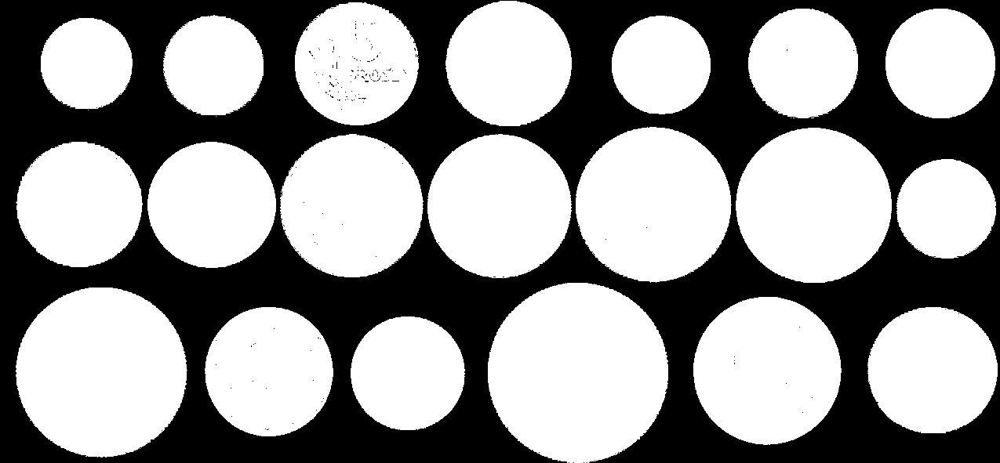

In [234]:
# binarize the image using red hue values
red_lower_1 = np.array([0, 170, 50])
red_upper_1 = np.array([10, 255, 255])
red_lower_2 = np.array([170, 170, 50])
red_upper_2 = np.array([180, 255, 255])

mask = cv2.inRange(monety_kolor_hsv, red_lower_1, red_upper_1) + cv2.inRange(monety_kolor_hsv, red_lower_2, red_upper_2)
mask = cv2.bitwise_not(mask)

Image.fromarray(mask)

Rozwiązanie części 2B:


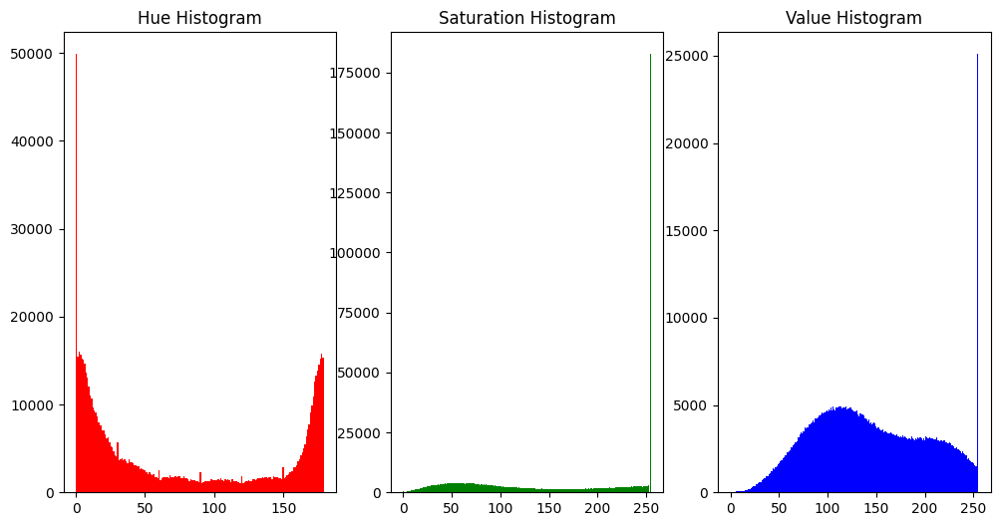

In [182]:
monety_kolor_szum_hsv = cv2.cvtColor(monety_kolor_szum, cv2.COLOR_BGR2HSV)
show_hsv_histogram(monety_kolor_szum)

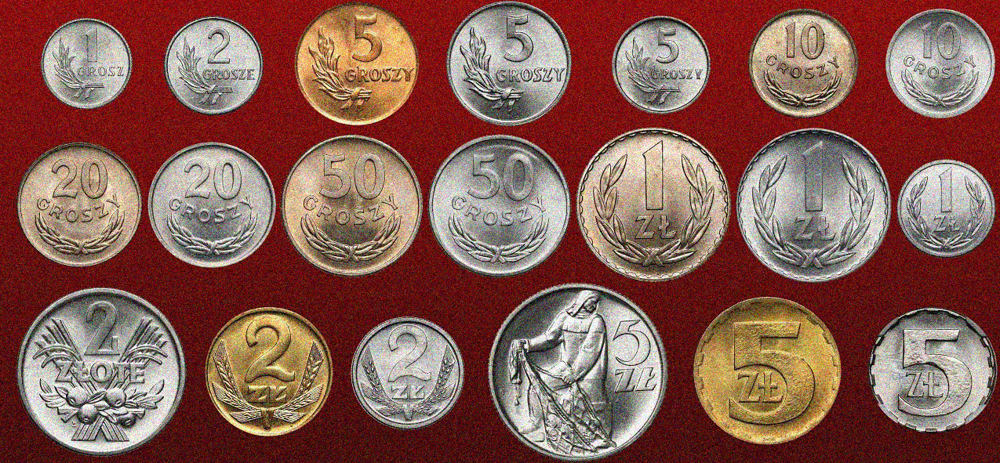

In [183]:
Image.fromarray(cv2.cvtColor(monety_kolor_szum_hsv, cv2.COLOR_HSV2RGB))

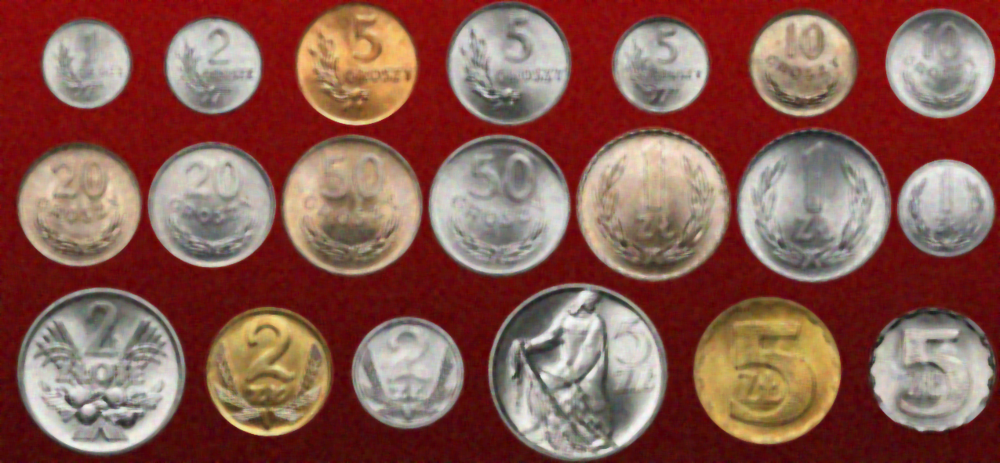

In [226]:
# use gaussian blur to remove noise
monety_kolor_szum_blur = cv2.medianBlur(monety_kolor_szum, 7)

# Display the blurred image
Image.fromarray(cv2.cvtColor(monety_kolor_szum_blur, cv2.COLOR_BGR2RGB))

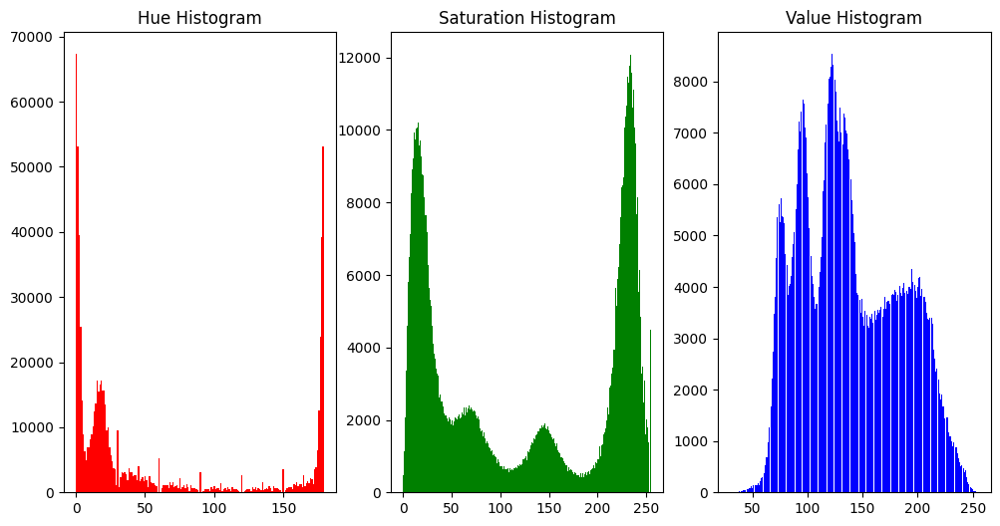

In [228]:
monety_kolor_szum_blur_hsv = cv2.cvtColor(monety_kolor_szum_blur, cv2.COLOR_BGR2HSV)
show_hsv_histogram(monety_kolor_szum_blur)

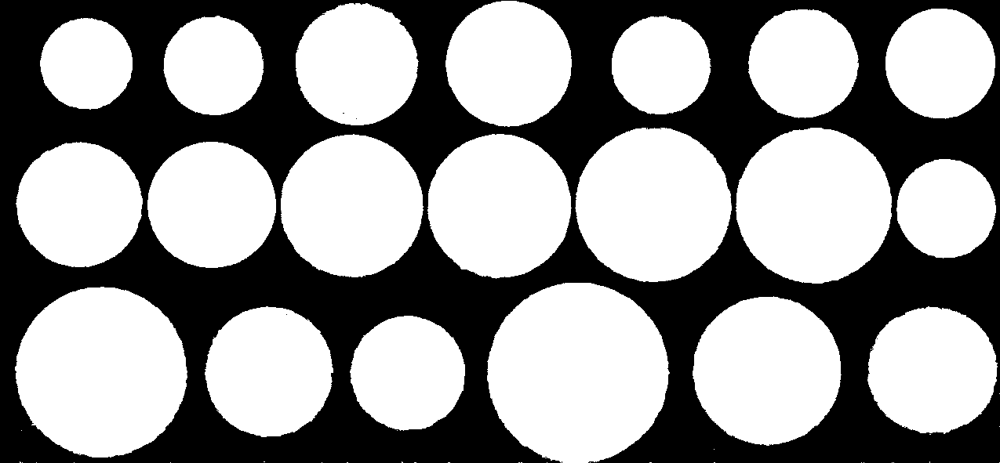

In [233]:
# binarize the image using red hue values
blur_red_lower_1 = np.array([0, 170, 50])
blur_red_upper_1 = np.array([10, 255, 255])
blur_red_lower_2 = np.array([170, 170, 50])
blur_red_upper_2 = np.array([180, 255, 255])

mask_blur = cv2.inRange(
    monety_kolor_szum_blur_hsv, blur_red_lower_1, blur_red_upper_1
) + cv2.inRange(monety_kolor_szum_blur_hsv, blur_red_lower_2, blur_red_upper_2)
mask_blur = cv2.bitwise_not(mask_blur)

Image.fromarray(mask_blur)

##### Zad. 3: Tekst

W tym przypadku należy wyodrębnić litery od bardzo nierównomiernie oświetlonego tła. Skorzystaj z binaryzacji metodą Otsu. Zastosuj binaryzację w sposób lokalny (oknem przesuwnym). Jaki wpływ ma rozmiar okna na jakość binaryzacji? Jak przesuwać okno?

_(Pełna punktacja za zadanie wymaga własnoręcznej implementacji okna przesuwnego i filtracji wewnątrz niego. Użycie zamiast tego_ `cv2.adaptiveThreshold` _liczone jako pół zadania, przy założeniu zrozumienia tej metody.)_

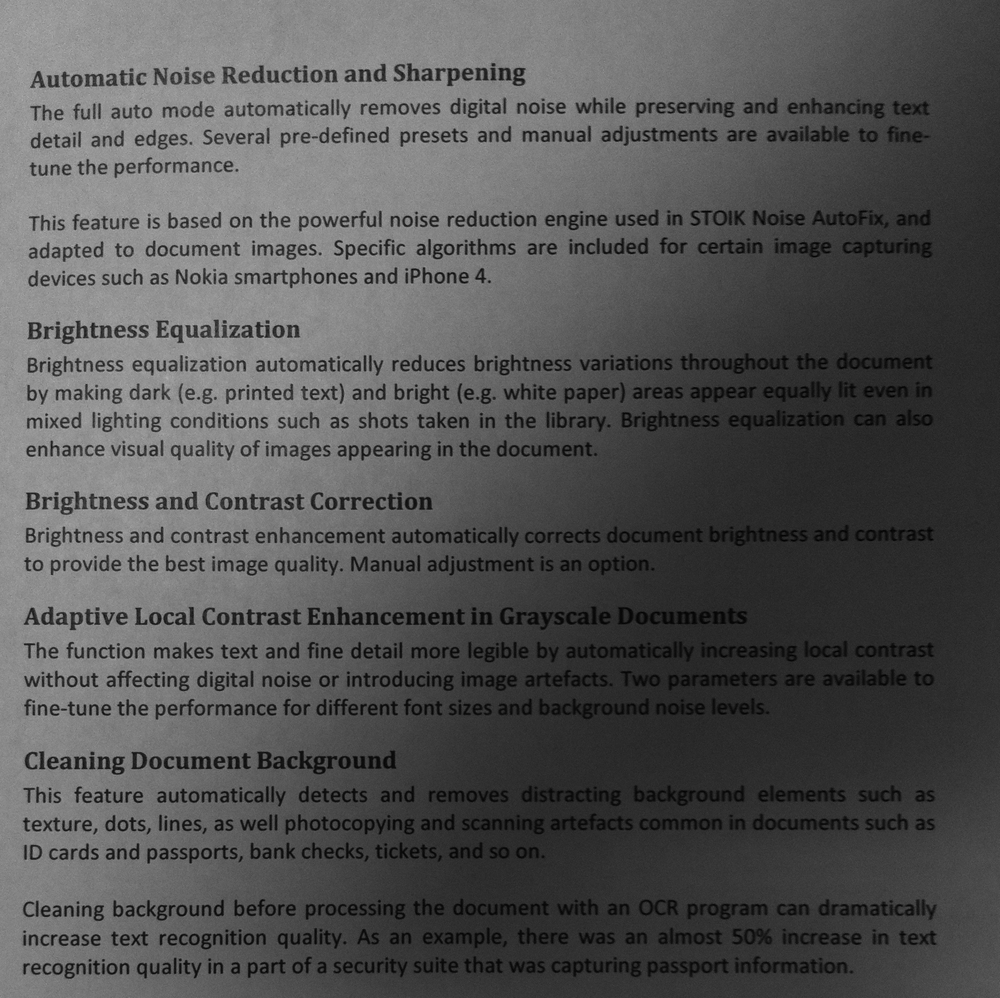

In [19]:
tekst = cv2.imread('Tekst1.bmp')
Image.fromarray(cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY))

Rozwiązanie:

Próg wyliczony algorytmem Otsu:  89.0


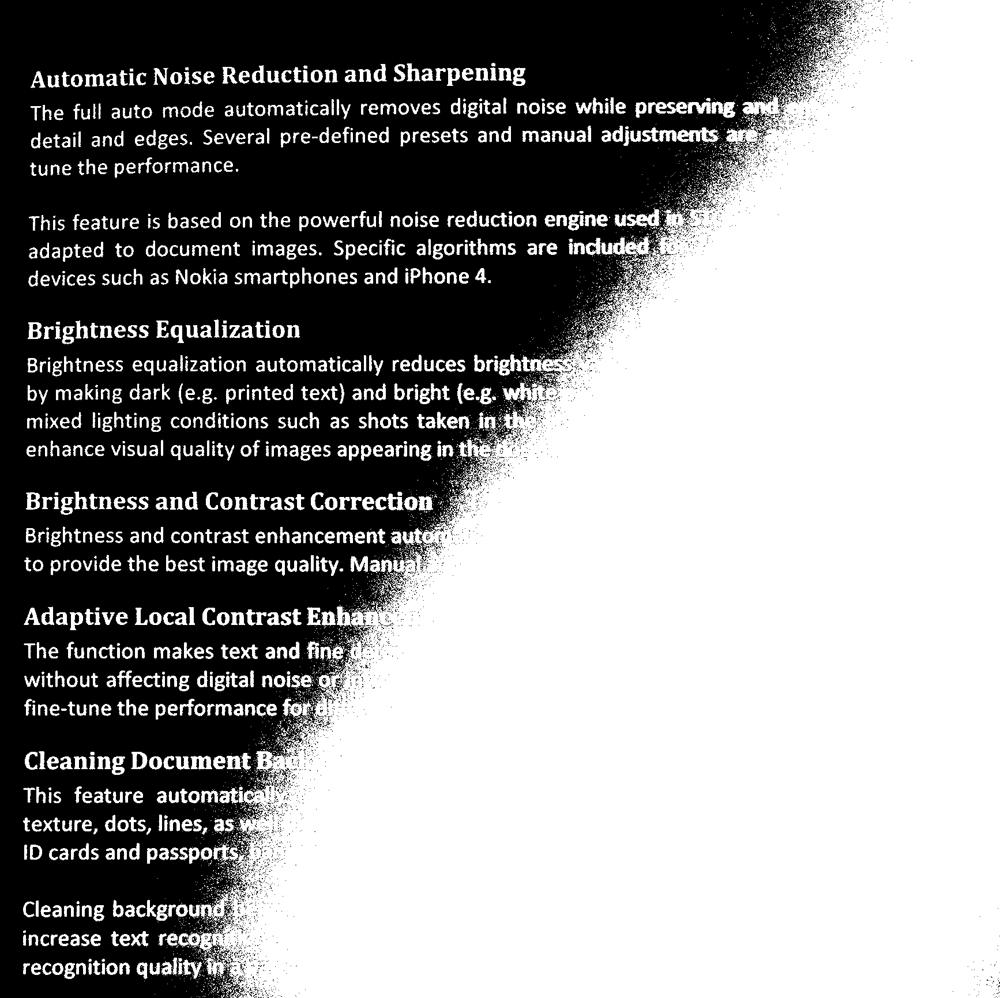

In [51]:
tekst_gray_otso = cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY)
T, tekst_gray_otso_thresh_img = cv2.threshold(
    tekst_gray_otso, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
)
print("Próg wyliczony algorytmem Otsu: ", T)

Image.fromarray(tekst_gray_otso_thresh_img)


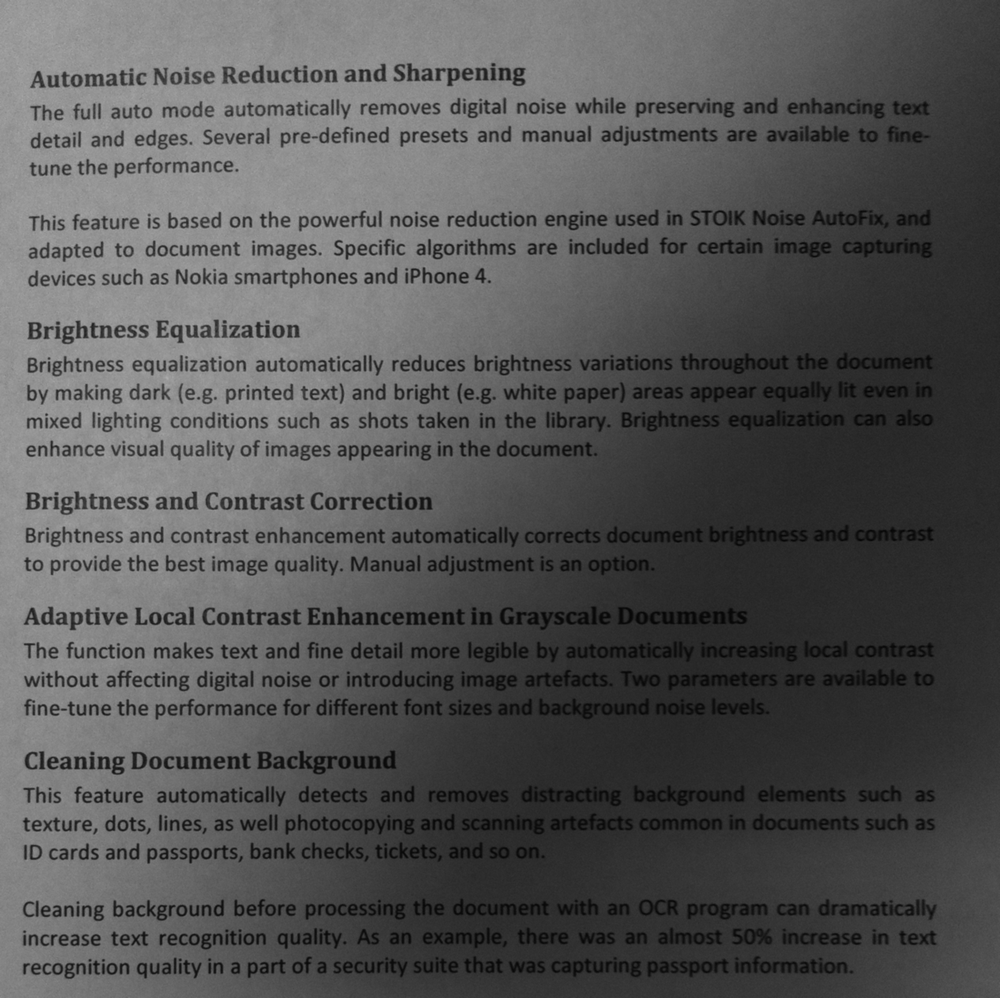

In [41]:
# apply Gaussian blur to the image
tekst_blur = cv2.GaussianBlur(tekst, (3, 3), 0)

# Display the blurred image
Image.fromarray(cv2.cvtColor(tekst_blur, cv2.COLOR_BGR2GRAY))

In [56]:
def apply_adaptive_threshold_mean(image, block_size, c):

    if block_size % 2 == 0:
        raise ValueError("block_size must be odd")
    
    height, width = image.shape
    output_image = np.zeros_like(image)

    for y in range(height):
        for x in range(width):
            block = image[
                max(0, y - block_size // 2) : min(height, y + block_size // 2),
                max(0, x - block_size // 2) : min(width, x + block_size // 2),
            ]
            threshold = np.mean(block) - c
            output_image[y, x] = 0 if image[y, x] > threshold else 255



    return output_image

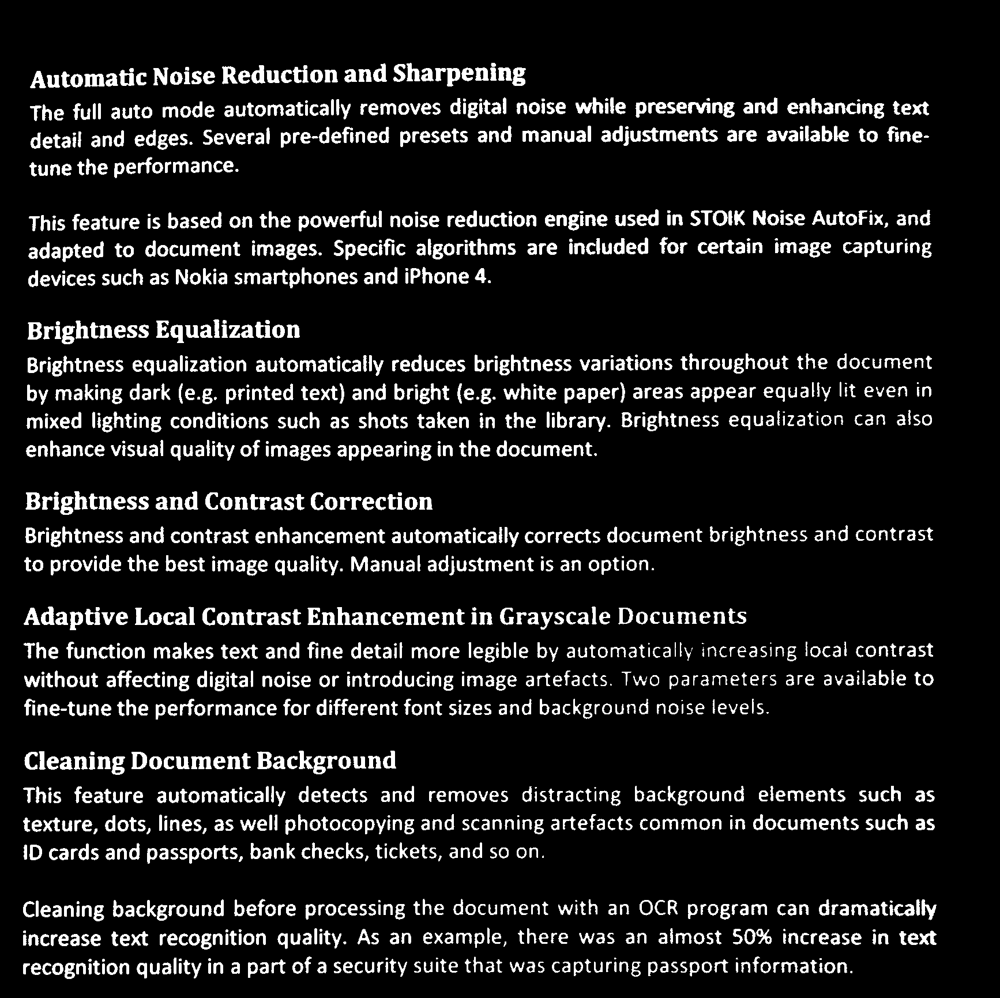

In [57]:
block_size = 251
c = 20
tekst_gray = cv2.cvtColor(tekst_blur, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_adaptive_threshold_mean(tekst_gray, block_size, c)

Image.fromarray(tekst_thresh)

In [49]:
def apply_custom_threshold(image, block_size):
    if block_size % 2 == 0:
        raise ValueError("block_size must be an odd number")

    height, width = image.shape
    output_image = np.zeros_like(image)

    half_window = block_size // 2

    padded_image = cv2.copyMakeBorder(
        image, half_window, half_window, half_window, half_window, cv2.BORDER_REFLECT
    )

    for y in range(height):
        for x in range(width):

            local_window = padded_image[y : y + block_size, x : x + block_size]

            T, img_thres = cv2.threshold(
                local_window, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
            )

            output_image[y, x] = img_thres[
                local_window.shape[0] // 2, local_window.shape[1] // 2
            ]

    return output_image

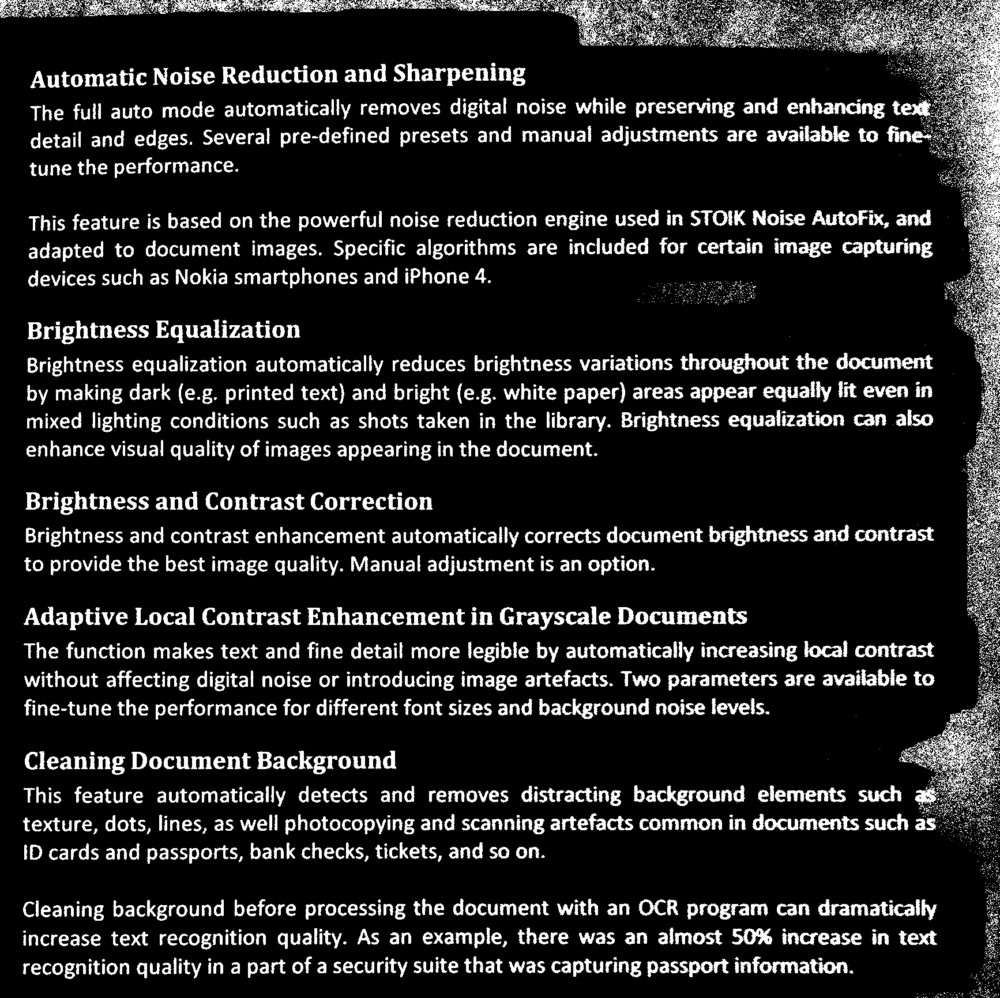

In [26]:
block_size = 201
tekst_gray = cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_custom_threshold(tekst_gray, block_size)

Image.fromarray(tekst_thresh)

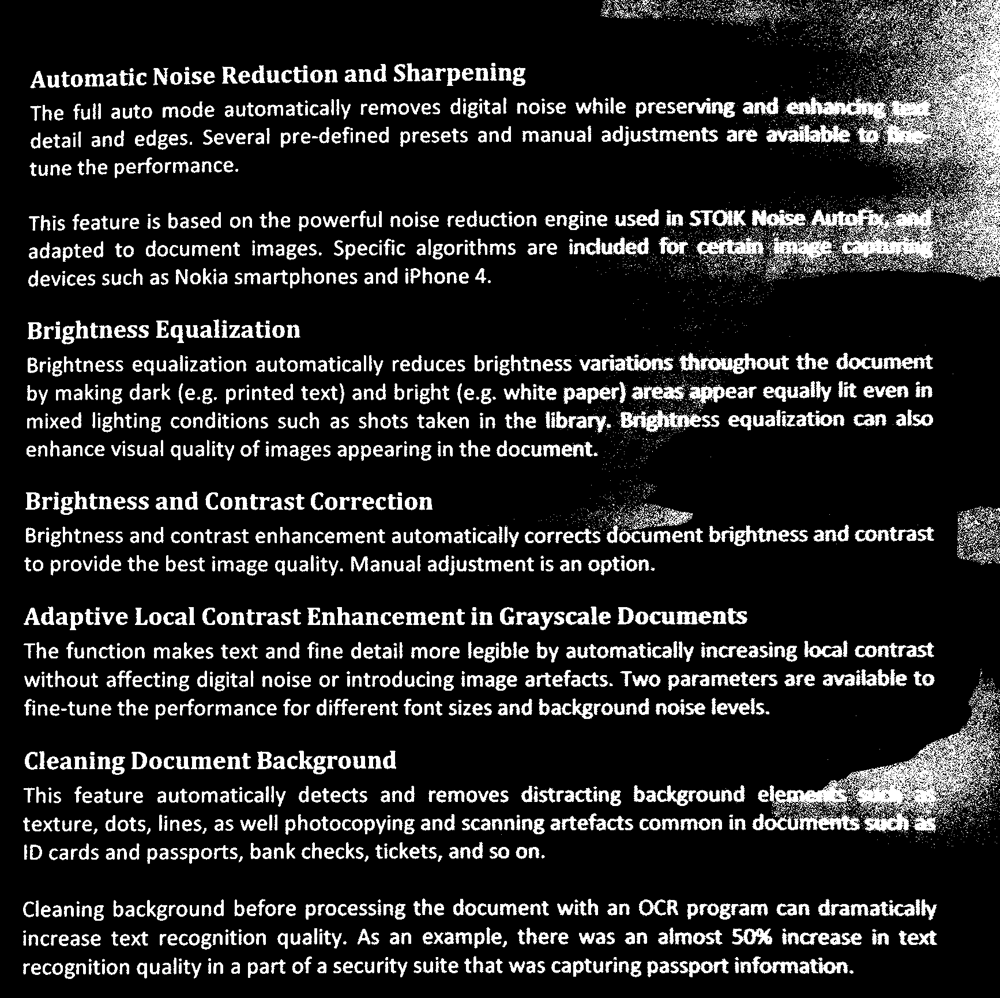

In [22]:
block_size = 301
tekst_gray = cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_custom_threshold(tekst_gray, block_size)

Image.fromarray(tekst_thresh)

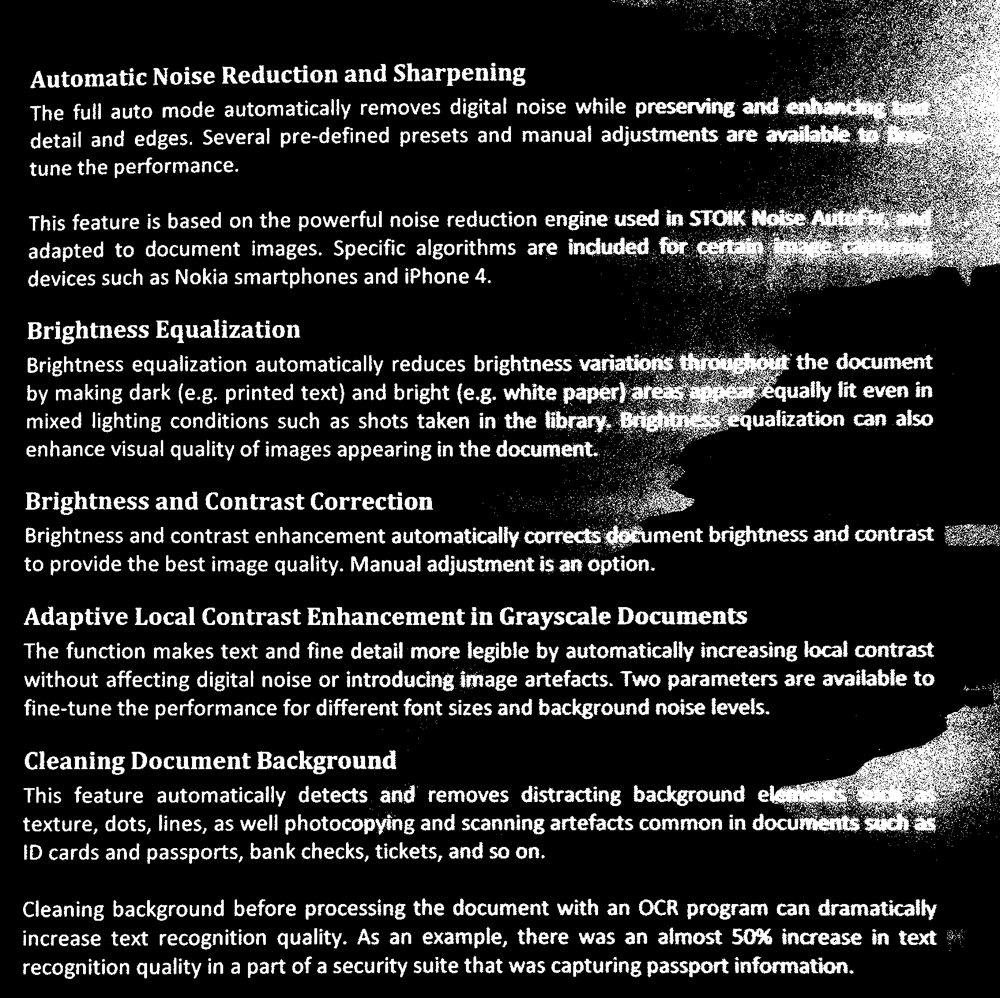

In [23]:
block_size = 351
tekst_gray = cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_custom_threshold(tekst_gray, block_size)

Image.fromarray(tekst_thresh)

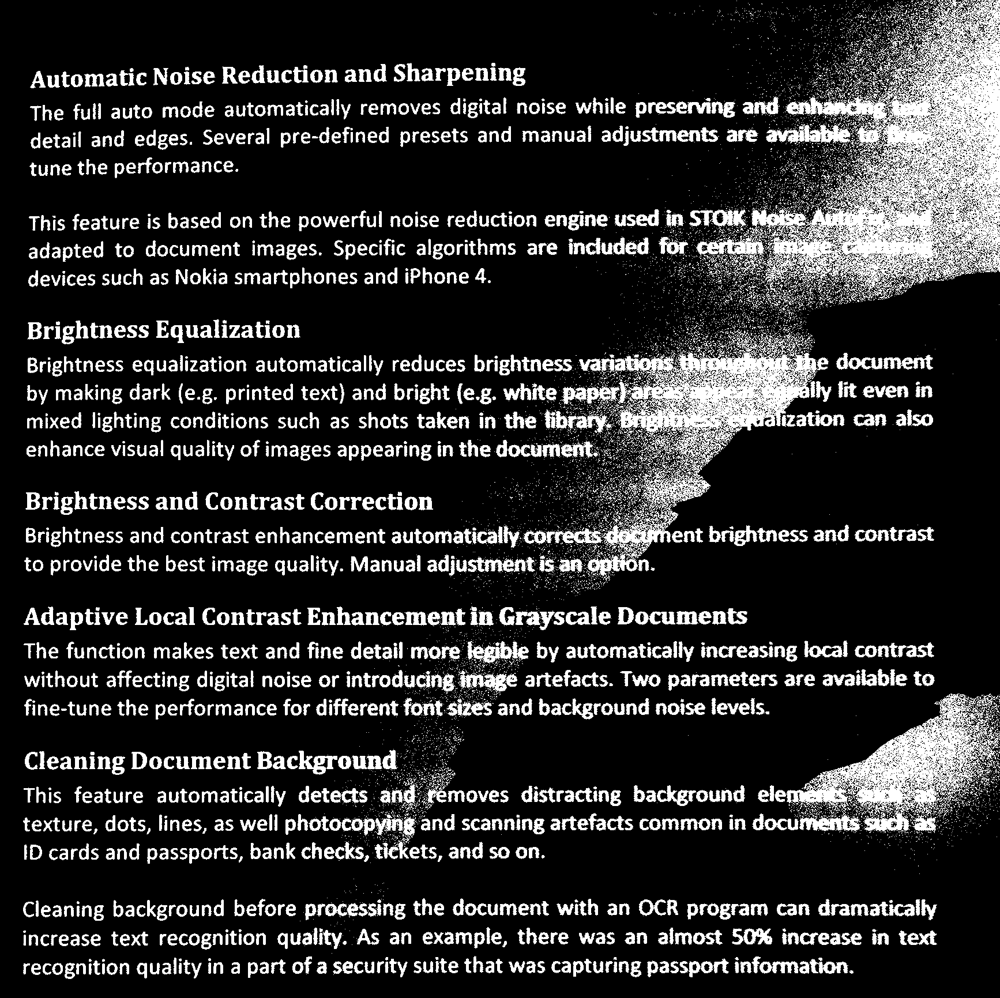

In [24]:
block_size = 401
tekst_gray = cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_custom_threshold(tekst_gray, block_size)

Image.fromarray(tekst_thresh)

### Porównanie z cv2.adaptiveThreshold

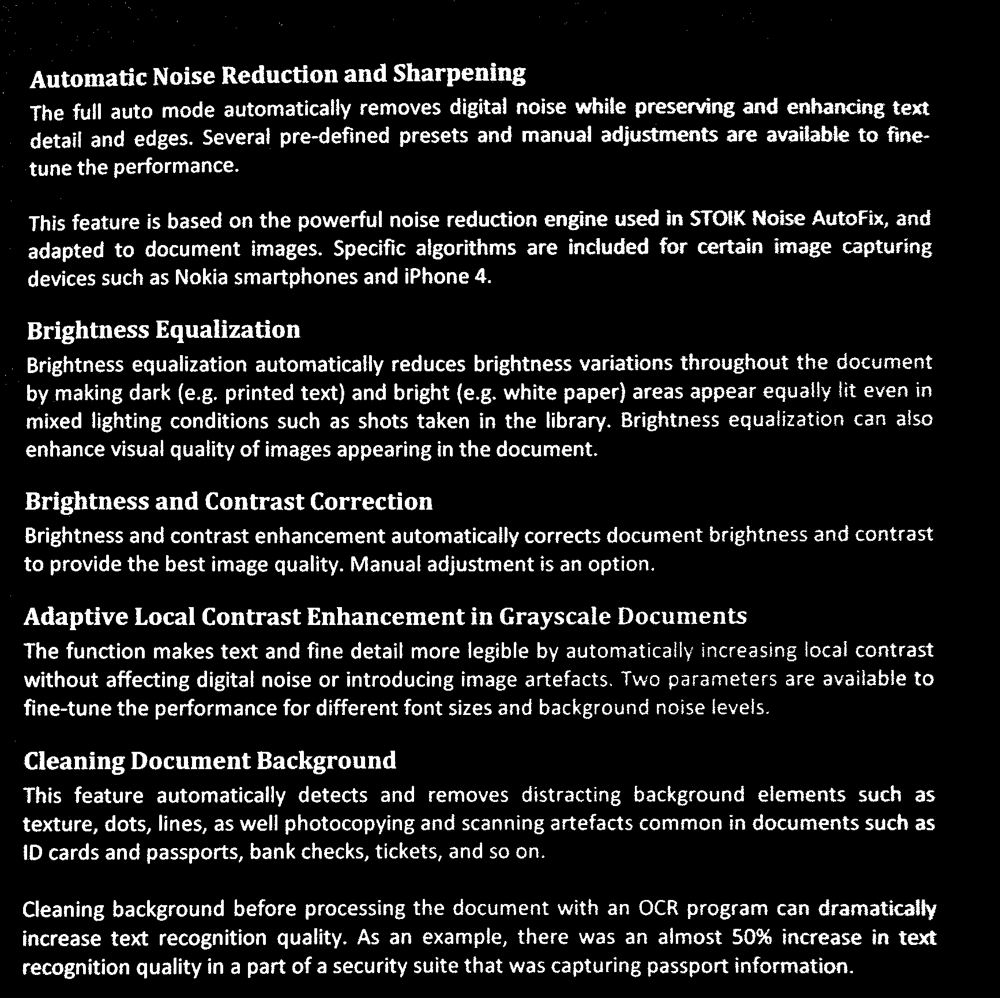

In [163]:
adaptive_thresh = cv2.adaptiveThreshold(
    tekst, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 251, 20
)

Image.fromarray(adaptive_thresh)